In [89]:
import numpy as np
import torch
import clip
import cv2
from IPython.display import Video
import matplotlib.pyplot as plt
from scipy import stats
from scipy.signal import savgol_filter

In [18]:
model, preprocess = clip.load("ViT-B/32")
model.cuda().eval()
input_resolution = model.visual.input_resolution
context_length = model.context_length
vocab_size = model.vocab_size

print("Model parameters:", f"{np.sum([int(np.prod(p.shape)) for p in model.parameters()]):,}")
print("Input resolution:", input_resolution)
print("Context length:", context_length)
print("Vocab size:", vocab_size)

Model parameters: 151,277,313
Input resolution: 224
Context length: 77
Vocab size: 49408


In [19]:
path = "..\\data\\videos\\ball_kick.mp4"
Video(path, embed=True)

In [20]:
def convert_mp4_to_imgs(path, img_size):
    images = []
    
    video_capture = cv2.VideoCapture(path)
    still_reading, image = video_capture.read()
    frame_count = 0
    while still_reading:
        images.append(cv2.resize(image, (img_size,img_size)))
        
        # read next image
        still_reading, image = video_capture.read()
        frame_count += 1
    
    return images, frame_count



In [21]:
images, num_frames = convert_mp4_to_imgs(path, input_resolution)

In [22]:
num_frames

255

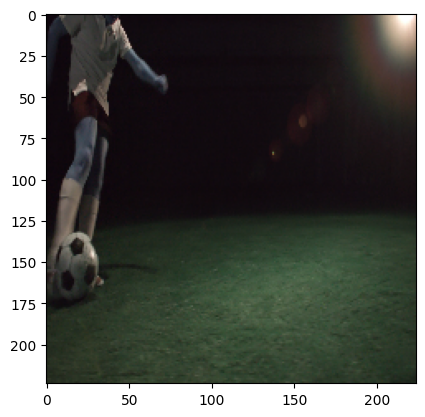

In [72]:
plt.imshow(images[89])

We see that the video is 255 frames. Let's sample every 10th frame.

In [82]:
sampling_rate = 1
query = "A photo of a person kicking a soccer ball"
sampled_images = images[0::sampling_rate]


Now that we have a query and a sampling of frames, let's run CLIP against every sampled frame. This should produce time-series data which is hopefully unimodal at the point where the action occured.  

In [83]:
image_input = torch.tensor(np.stack(sampled_images)).permute(0,3,1,2).cuda()
text_tokens = clip.tokenize([query]).cuda()
with torch.no_grad():
    image_features = model.encode_image(image_input).float()
    text_features = model.encode_text(text_tokens).float()

In [84]:
image_features /= image_features.norm(dim=-1, keepdim=True)
text_features /= text_features.norm(dim=-1, keepdim=True)
similarity = text_features.cpu().numpy() @ image_features.cpu().numpy().T

In [85]:
normalized_similarity = stats.zscore(similarity[0])
print(normalized_similarity)

[ 1.3834115   1.226971    1.4107727   1.3246095   1.445186    1.5445473
  1.4189384   1.4421146   1.4193467   1.5236475   1.5028467   1.4276515
  1.5984468   1.665628    1.70173     1.6522969   1.6579696   1.5633067
  1.5120207   1.2899085   1.0324644   1.2586068   1.748061    1.688795
  1.942048    1.6729833   1.6924169   1.5748345   1.4495472   1.1687165
  1.0491762   0.9998265   0.8035382   0.65021557  0.09600529 -0.29662386
 -0.18027245 -0.20051648 -0.6535932  -0.89250684 -0.02339895  0.41930053
  0.30914763  0.4676821   1.618929    0.697496    0.38203233 -0.01721903
  0.03846522  0.0194584  -0.36626396 -0.4981239  -0.2412056   0.6499928
  1.4021462   1.0371504   1.2066312   2.08083     1.2884889   0.62091815
 -0.25041673  0.4724392   0.9666906   1.1380953   0.65625626  0.76447916
 -0.0075254   0.84648216  0.1257914   0.2175592  -0.98996896 -1.6458943
 -1.4815573  -1.3341175  -0.5912712  -0.14123501 -0.8436397  -0.6440171
 -1.1839807  -1.4922715  -1.9430872  -1.9793657  -2.406801  

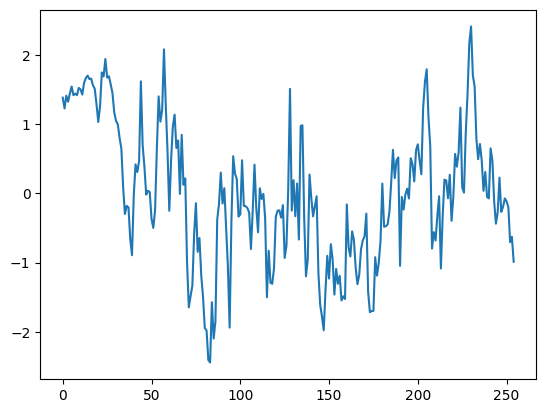

In [86]:
plt.plot(normalized_similarity)

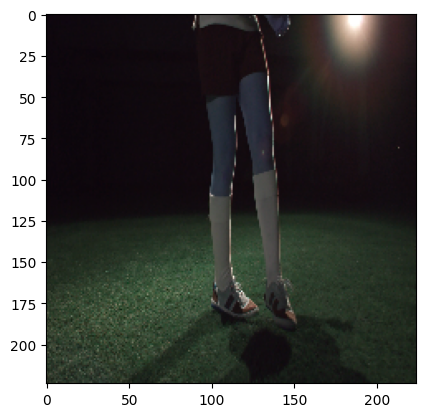

In [88]:
plt.imshow(images[np.argmax(normalized_similarity)*sampling_rate])

Do the results change if we smooth the time series data?

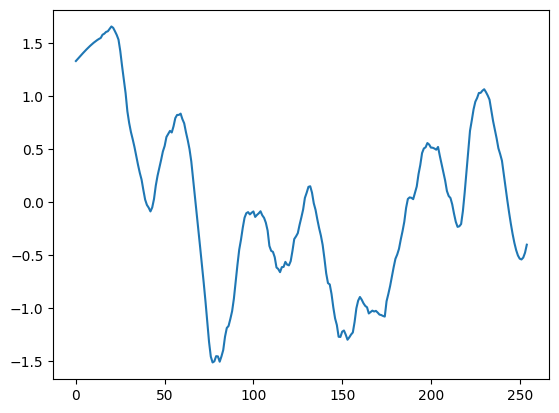

In [93]:
filtered_similarity = savgol_filter(normalized_similarity, 30, 3)
plt.plot(filtered_similarity)

In [ ]:
plt.imshow(images[np.argmax(filtered_similarity)*sampling_rate])

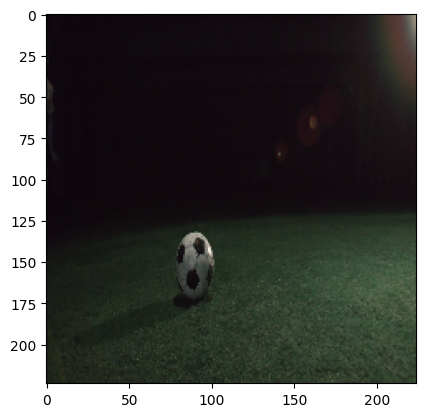

In [95]:
true_frame = 89
plt.imshow(images[np.argmax(filtered_similarity)*sampling_rate])

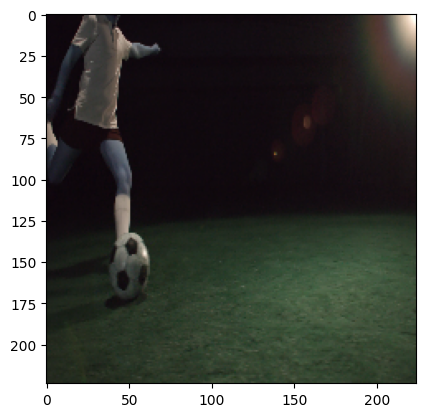

In [97]:
plt.imshow(images[np.argmin(filtered_similarity)*sampling_rate])

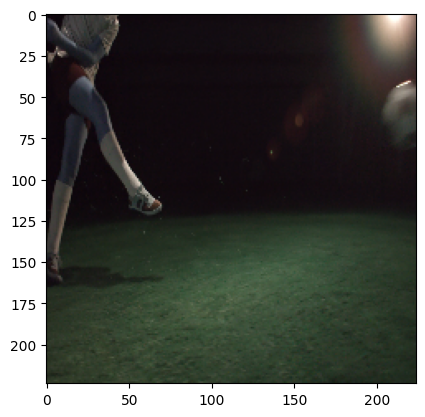

In [99]:
plt.imshow(images[100])

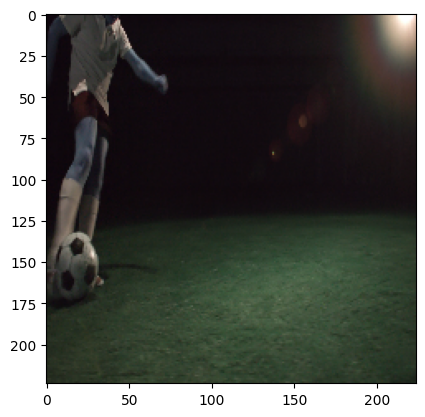

In [98]:
true_frame = 89
plt.imshow(images[true_frame])